Tutorial 3: Automated Annotation of Cell Identities in mIHC Data
================================================================

In this tutorial, we demonstrate how to use ImmunoPheno to annotate cell identities in a multiplexed IHC dataset using reference data stored in the ImmunoPhenoDB database. Specifically, we consider a human tonsil tissue section that has been profiled with PhenoCycler using a panel of 26 antibodies. For illustration purposes, we will only consider a small portion of the tissue section containing ~118k cells. The data can be found in this [link](https://www.dropbox.com/scl/fi/d03airv7b1bimyy8n99jz/codex_small.zip?rlkey=4php5lnz5a7r096kopb3h4b01&dl=0).

In [2]:
import pandas as pd
import pickle
import numpy as np
import plotly.express as px
import seaborn as sns
from immunopheno.data_processing import ImmunoPhenoData
from immunopheno.connect import ImmunoPhenoDB_Connect
from immunopheno.plots import plot_filter_metrics
from sklearn.metrics.pairwise import euclidean_distances

We can visualize the spatial location of the cells in the tissue:

In [3]:
spat_small = pd.read_csv("codex_small_coordinates.csv", index_col = 0)
fig = px.scatter(spat_small, x="x", y="y").update_traces(marker={'size': 1.0}).update_layout(autosize=False, height=800, width=1000).update_yaxes(scaleanchor="x",
    scaleratio=1)
fig.show()

To annotate the dataset, we first create an `ImmunoPhenoData` object containing the PhenoCycler protein expression matrix

In [4]:
ipd = ImmunoPhenoData(protein_matrix = 'codex_small_protein.csv', spreadsheet = "codex_small_spreadsheet.csv")

In addition to the protein expression matrix, we need to provide a spreadsheet containing the RRID identifiers of the monoclonal antibodies used in the experiment. This is because ImmunoPheno will use data from experiments that have used those exact antibodies or, alternatively, monoclonal antibodies from a different vendor but with the same clone ID. The file `codex_small_spreadsheet.csv` can be used as a template for your own datasets.

We first need to normalize the mIHC data using ImmunoPheno, following the procedure demonstrated in Tutorial 2. For mIHC data, a Gaussian mixture model produces optimal results for most technologies.

In [5]:
ipd.fit_all_antibodies(model="gaussian")

  0%|          | 0/26 [00:00<?, ?it/s]

Number of 3 component models: 23
Number of 2 component models: 3
Number of 1 component models: 0


In [6]:
ipd.normalize_all_antibodies(sig_expr_threshold = 0.80, bg_expr_threshold = 0.10)

  0%|          | 0/26 [00:00<?, ?it/s]

More information about good practices for normalizing protein expression values using ImmunoPheno can be found in Tutorial 2.

Once we have normalized the protein expression values, we can proceed to annotating the identity of each cell based on the information contained in the ImmunoPhenoDB database.

We first create an instance of `ImmunoPhenoDB_Connect`, which will allow us to interact with the ImmunoPhenoDB database.

In [7]:
cxn = ImmunoPhenoDB_Connect("http://immunopheno.org")

Loading necessary files...
Connecting to database...
Connected to database.


We can see a summary of what is currently in the database using the command `db_stats()`

In [8]:
cxn.db_stats()

Database Statistics
Number of experiments: 18
Number of tissues: 7
Number of cells: 115979
Number of antibodies: 646
Number of antibody targets: 294
Number of antibody clones: 390
Average number of experiments per antibody: 2.68


We can choose to restrict the reference data to experiments using the same tissue type or to specific experiments. In this example, we will use all available data from human tonsils.

In [9]:
cxn.which_experiments("tonsil")

,idExperiment,nameExp,typeExp,pmid,doi,idBTO,tissue
0,4,Childhood Hematopoiesis and Immune Development...,CITE,0,https://doi.org,BTO:0001387,tonsil
1,5,Childhood Hematopoiesis and Immune Development...,CITE,0,https://doi.org,BTO:0001387,tonsil
2,6,Childhood Hematopoiesis and Immune Development...,CITE,0,https://doi.org,BTO:0001387,tonsil


We observe that there are 5 experiments in the ImmunoPhenoDB database with data from human tonsils. The [BRENDA tissue ontology](https://www.ebi.ac.uk/ols4/ontologies/bto) ID of the tonsil is `BTO:0001387`.

We now call `run_stvea()` to automatically annotate the identity of individual cells in the PhenoCycler data using reference data from the database. You may need to increase the number of chunks depending on the amount of memory available in your computer, as described below.

In [10]:
ipd_new = cxn.run_stvea(ipd, idBTO=["BTO:0001387"], num_chunks=4)

Retrieving reference dataset...
Number of antibodies matched from database using clone ID: 26
Imputing missing values...
Number of antibodies imputed: 0
Number of cells imputed: 0
Number of cell types imputed: 0
Remaining number of antibodies after imputation: 26
Remaining number of cells after imputation: 10000
Running STvEA...
Processing chunk of size:  28599
run_cca. Time: 24.067 sec
find_nn_rna Time: 52.528 sec
find_anchor_pairs Time: 4.319 sec
filter_anchors Retained 15800 anchors! Time: 20.376 sec
score_anchors. Time: 5.955 sec
find_integration_matrix Time: 0.005 sec
find_weights Time: 36.687 sec
transform_data_matrix Time: 0.668 sec
Processing chunk of size:  28599
run_cca. Time: 22.747 sec
find_nn_rna Time: 44.936 sec
find_anchor_pairs Time: 4.322 sec
filter_anchors Retained 15970 anchors! Time: 20.079 sec
score_anchors. Time: 6.244 sec
find_integration_matrix Time: 0.008 sec
find_weights Time: 37.281 sec
transform_data_matrix Time: 0.706 sec
Processing chunk of size:  28598
ru

We have mostly used the default parameters of `run_stvea()`. This function is memory-intensive, and to execute it on a standard desktop, the data needs to be partitioned into chunks. Having chunks of approximately 10,000-30,000 cells is usually a good approach. Here, we have divided the dataset into `num_chunks=4` chunks. We have also restricted the reference data to human tonsils using the argument `idBTO=["BTO:0001387"]`. In general, using data from the same tissue type will lead to more accurate annotations, unless there is very limited data from that tissue in the database.

Another option of `run_stvea()` that is frequently used is `parse_option`. Here, we have used the default `parse_option=1`, which uses reference data from monoclonal antibodies from the same clone but potentially different vendors or with different modifications, such as different conjugated oligos or fluorophores, as those in the query mIHC dataset. Setting `parse_option=2` is less constraining, requiring only that the antibody protein targets match between the reference and the mIHC data. On the other hand, `parse_option=3` is more stringent, requiring the same exact antibodies (including vendor, etc.) between the reference and mIHC data. We find that `parse_option=1` generally offers the best results, except in situations where there is little overlap between the clones used in the mIHC experiment and those present in the database.

`run_stvea()` also offers the possibility of parallelization for shorter runtime, where the number of cores is specified by the argument `num_cores`. However, this increases the memory requirements. Finally, `run_stvea()` includes numerous arguments related to the mapping algorithm that may need to be adjusted for optimal results depending on the specific dataset and available computing resources. These are described in detail in the documentation of ImmunoPheno and in the original [STvEA paper](https://doi.org/10.1126/sciadv.abc5464). Increasing the value of "k" parameters, particularly `k_transfer_matrix` and `k_find_anchor`, will often increase the number of anchors and the accuracy of the annotations at the expense of a substantially larger runtime and memory requirements. Generally, for chunks of 10,000-30,000 cells, it is desirable to obtain at least ~10,000 anchors. For large datasets, we recommend experimenting with different parameter options, monitoring memory usage, on a subset of the data before running `run_stvea()` on the entire dataset.

The cell annotations are stored in the field `labels` of the ImmunoPheno object

In [11]:
print(ipd_new.labels["celltype"].value_counts().to_string())

celltype
naive B cell                                                 45896
central memory CD4-positive, alpha-beta T cell               13377
naive thymus-derived CD4-positive, alpha-beta T cell          7485
T follicular helper cell                                      5740
CD8-positive, alpha-beta T cell                               5607
blood vessel endothelial cell                                 5547
memory B cell                                                 4946
bronchial smooth muscle cell                                  4871
centroblast                                                   4689
CD4-positive, CD25-positive, alpha-beta regulatory T cell     3525
plasmacytoid dendritic cell                                   2738
conventional dendritic cell                                   2342
epithelial cell                                               1659
follicular dendritic cell                                     1104
monocyte                                             

Cell assignments are based on the cell type that has the highest probability for each cell. The field `cell_type_prob` contains a table with the cell-type probabilities for each cell. From this table, we can observe that some cell subtypes are harder to distinguish than others

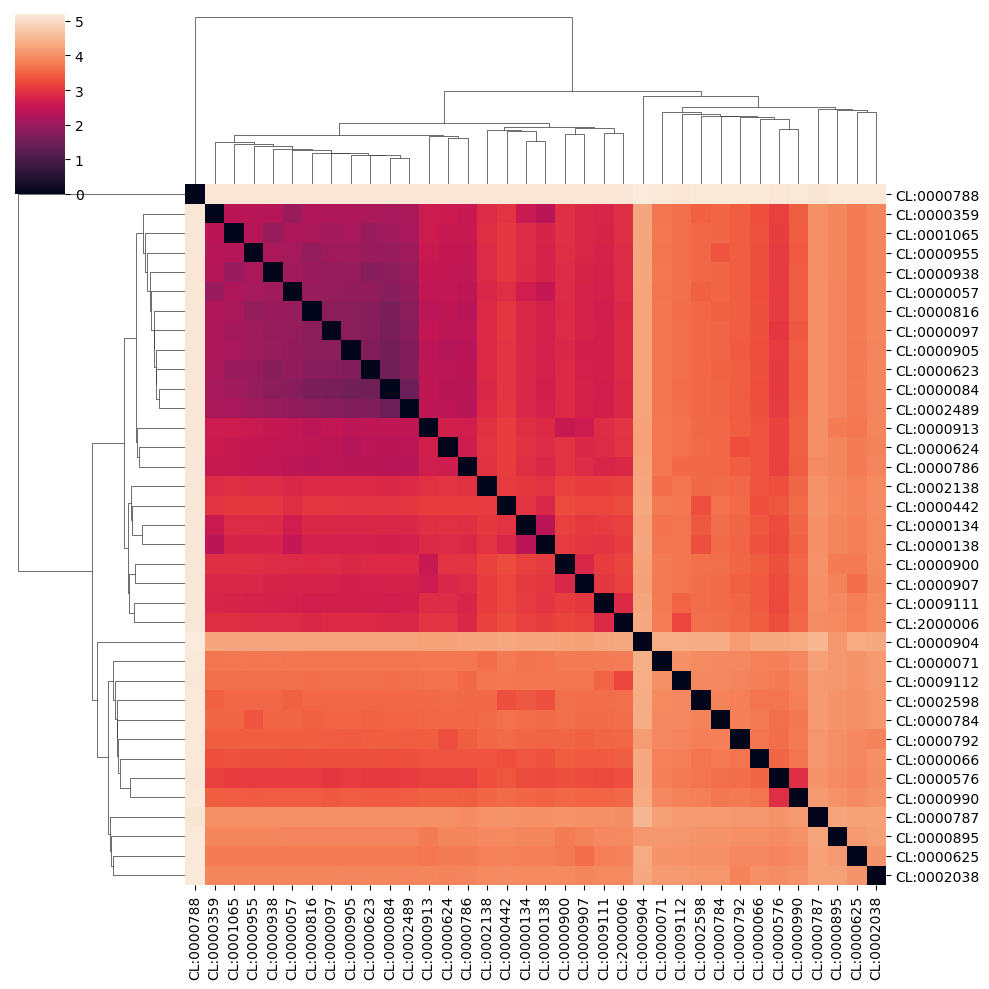

In [12]:
sns.clustermap(np.log(1+euclidean_distances(ipd_new.cell_type_prob.transpose())), xticklabels = ipd_new.cell_type_prob.transpose().index, yticklabels = ipd_new.cell_type_prob.transpose().index)

For example, we observe that distinguishing Natural Killer cells (`CL:0000623`) from CD16-negative CD56-high Natural Killer cells (`CL:0000938`) is difficult, as the former contains the latter. However, distinguishing plasmacytoid dendritic cells (`CL:0000784`) from all the other cell types is much easier. ImmunoPheno quantifies the uncertainty in the cell type assignment for each cell by computing the entropy (in base 2) of the vector of cell type probabilities for each cell. If a cell is annotated with a specific cell type with probability 1, the entropy for that cell will be zero, while cells with more uncertain assignments will have larger entropy. The maximum possible value of the entropy is log2(N), with N being the number of cell types in the dataset. The field `entropies` of the ImmunoPheno object contains the entropy of the cell assignments for each cell.

Another metric that is informative about the quality of each annotation is the ratio between D1 and D2, where D1 is the average distance in the consolidated protein space between the mIHC dataset query cell and the nearest `k_transfer_matrix` neighbors from the reference data, and D2 is the average pairwise distance in the consolidated protein space between the nearest `k_transfer_matrix` neighbors in the reference dataset, where `k_transfer_matrix` is specified in the call to `run_stvea()` (default `k_transfer_matrix=40`). A smaller value of the ratio indicates a better mapping. The field `distance_ratios` of the ImmunoPheno object contains the ratio between D1 and D2 for each cell.

The distributions of entropies and D1/D2 ratios can be visualized using `plot_filter_metrics()`

In [13]:
plot_filter_metrics(ipd_new)

As detailed above, the quality of the annotations can be increased by taking larger values of `k_transfer_matrix` and `k_find_anchor` in `run_stvea()`, and this should be reflected in these metrics.

We can filter out poor-quality annotations based on these two quantities using `filter_labels()`. In this example, we will filter out cells with D1/D2 > 2 and entropy > 3

In [14]:
ipd_new = cxn.filter_labels(ipd_new, distance_ratio = True, entropy = True, distance_ratio_threshold=2, entropy_threshold = 3)

Performing nearest neighbor distance ratio filtering...
Number of cells renamed to 'Not Assigned': 1184
epithelial cell (CL:0000066): 1
blood vessel endothelial cell (CL:0000071): 37
mesenchymal stem cell (CL:0000134): 15
vascular associated smooth muscle cell (CL:0000359): 2
CD8-positive, alpha-beta T cell (CL:0000625): 85
memory B cell (CL:0000787): 9
naive B cell (CL:0000788): 536
naive thymus-derived CD4-positive, alpha-beta T cell (CL:0000895): 106
naive thymus-derived CD8-positive, alpha-beta T cell (CL:0000900): 35
central memory CD4-positive, alpha-beta T cell (CL:0000904): 273
T follicular helper cell (CL:0002038): 52
bronchial smooth muscle cell (CL:0002598): 33
Distance_ratio filtering complete.

Performing cell type entropy filtering...
Number of cells renamed to 'Not Assigned': 9770
epithelial cell (CL:0000066): 128
blood vessel endothelial cell (CL:0000071): 1849
mast cell (CL:0000097): 4
mesenchymal stem cell (CL:0000134): 288
chondrocyte (CL:0000138): 54
vascular associ

In addition, ImmunoPheno can identify and filter out low-quality annotations by looking at the localization of the annotations in the mIHC protein expression space. Cells annotated in the same manner but with inconsistent protein expression profiles (and therefore randomly scattered in the protein expression space) will be removed. Additionally, different annotations that cannot be separated in the protein expression space are merged into a single annotation.

In [15]:
ipd_new = cxn.filter_labels(ipd_new, localization = True, merging = True)

Performing localization...
Downsampling dataset to 5000 cells...
Calculating pairwise distances between cells...
Generating cell graph...
Conducting fisher exact test for each cell type...
Number of cell types to rename: 4
epithelial cell (CL:0000066): 1530
vascular associated smooth muscle cell (CL:0000359): 10
monocyte (CL:0000576): 866
innate lymphoid cell (CL:0001065): 149
Renaming 2555 cells with 'Not Assigned' label...
Renamed 2555 cells.
Localization complete.

Performing merging...
Replacing all cells of CL:0000623 with CL:0000938
Number of cell types merged: 0
Merging complete.



Filtered out cells are labeled as `Not Assigned`

In [16]:
print(ipd_new.labels["celltype"].value_counts().to_string())

celltype
naive B cell                                                 43957
Not Assigned                                                 13509
central memory CD4-positive, alpha-beta T cell               11199
naive thymus-derived CD4-positive, alpha-beta T cell          6791
T follicular helper cell                                      5411
CD8-positive, alpha-beta T cell                               4859
memory B cell                                                 4657
centroblast                                                   4647
bronchial smooth muscle cell                                  4170
blood vessel endothelial cell                                 3661
CD4-positive, CD25-positive, alpha-beta regulatory T cell     3122
plasmacytoid dendritic cell                                   2487
conventional dendritic cell                                   2169
follicular dendritic cell                                     1014
naive thymus-derived CD8-positive, alpha-beta T cell 

The location of the annotated cells in the tissue section recapitulates the known architecture of human tonsils,

In [19]:
spat_small.loc[ipd_new.labels.index, "celltype"] = ipd_new.labels["celltype"]
fig = px.scatter(spat_small, x="x", y="y", color="celltype", 
                 color_discrete_sequence=px.colors.qualitative.Vivid_r).update_traces(marker={'size': 1.4}).update_layout(autosize=False, height=1000, width=1500).update_yaxes(scaleanchor="x",
    scaleratio=1)
fig.show()

Finally, we can serialize the annotated ImmunoPheno object into a pickle file for future use

In [44]:
## To save the ImmunoPheno object into a pickle file
with open('ipd_new_pickle', 'wb') as sample:
    pickle.dump(ipd_new, sample)

## To load the ImmunoPheno object from the pickle file:
# with open('ipd_new_pickle', 'rb') as sample:
#     ipd_new = pickle.load(sample)